# Largeur des graphes

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt 
import matplotlib.dates as mdates
import os

from datetime import datetime

## 1. Introduction

Pour ce notebook, on va se pencher sur la largeur des graphes de git et l'évolution de cette largeur au cours du développement.

Dans notre cas, on a accès pour chaque graphes à un fichier .tslog qui contient les paires noeud, timestamp. De plus, une branche de graphe est dite "en vie" tant qu'elle n'a pas merge avec une autre. La largeur va donc être le nombre de branche encore en vie au timestamp courant.

La largeur d'un graphe sera alors la largeur maximale enregistrée. Pour l'évolution de la largeur, on va parcourir le graphe timestamp par timestamp et noter le nombre de branche actives à ce moment là.

## 2. Evolution de la largeur

Nous allons commencer par l'évolution de la largeur. Pour notre analyse, nous allons pour chaque graphe créer 4 sous-graphes :
- un sous-graphe complet qui est exactement le graphe d'origine, on va l'appeller **All**
- un sous-graphe avec toutes les racines d'origines mais avec seulement la feuille de la branche main (donc toutes les branches ne se terminant pas sur le main ne sont pas incluses), on va l'appeller **MainLeaf**
- un sous-graphe avec toutes les feuilles d'origines mais avec seulement la racine de la branche main (donc toutes les branches ne commençant pas depuis le main ne sont pas incluses), on va l'appeller **MainRoot**
- un sous-graphe avec uniquement la racine et la feuille du main (ce graphe ne contnient que les branches qui commencent et terminent sur le main), on va l'appeller **MainOnly**

Nous avons à notre dispostion deux répertoires **WidthOR** et **WidthAL**. Chaque répertoire contient un CSV par graphe, chaque graphe a donc deux CSV en tout. WidthOR contient les CSV avec les colonnes :
- Timestamp : les timestamps dans l'ordre
- WidthMainOnly : au timestamp correspondant, le nombre de branches en vie pour le sous-graphe MainOnly
- WidthMainRoot : au timestamp correspondant, le nombre de branches en vie pour le sous-graphe MainRoot
WidthAl contient les CSV avec les colonnes :
- Timestamp : les timestamps dans l'ordre
- WidthAll : au timestamp correspondant, le nombre de branches en vie pour le sous-graphe All
- WidthMainLeaf : au timestamp correspondant, le nombre de branches en vie pour le sous-graphe MainLeaf

Pour chaque graphe, on va donc tracer 4 graphiques qui montrent l'évolution de la largeur en fonction du temps.
On utilisera le code couleur suivant pour les graphiques : 
- **violet** = MainOnly
- **bleu** = MainLeaf
- **orange** = MainRoot
- **jaune** = All

Par soucis de place, les répertoires WidthOR et WidthAL sont compressé sous format .zip dans **CSV/GitDAG/Width.zip**.

In [2]:
# Changer les chemin vers WidthOR / WidthAL si besoin
path_widthOR = "~/Documents/StageM1/Tests_graph/GitDAG/WidthOR" 
path_widthAL = "~/Documents/StageM1/Tests_graph/GitDAG/WidthAL"

widthOR_dir = os.path.expanduser(path_widthOR)
widthAL_dir = os.path.expanduser(path_widthAL)

In [9]:
def plot_width_evolution(file, column, colorC, i=None, total=None, formatD=True):
    df = pd.read_csv(file)

    df = df[["Timestamp", column]].dropna()
    df = df.sort_values("Timestamp")

    x = pd.to_datetime(df["Timestamp"], unit="s").to_numpy() if formatD else df["Timestamp"].to_numpy()
    y = df[column].to_numpy()

    plt.figure(figsize=(12, 6))
    if formatD:
        plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m'))
        plt.gca().xaxis.set_major_locator(mdates.YearLocator())
        plt.xticks(rotation=45)
    plt.plot(x, y, linestyle='-', marker='x', color=colorC)
    file_name = os.path.basename(file)[:-len("_width.csv")]
    title = f"Width Evolution - {file_name} [{i}/{total}]" if i is not None and total is not None else f"Width Evolution - {file_name}"
    plt.title(title)
    plt.xlabel("Timestamps")
    plt.ylabel("Largeur (nb de branches)")
    plt.grid(True)
    plt.tight_layout()
    plt.show()

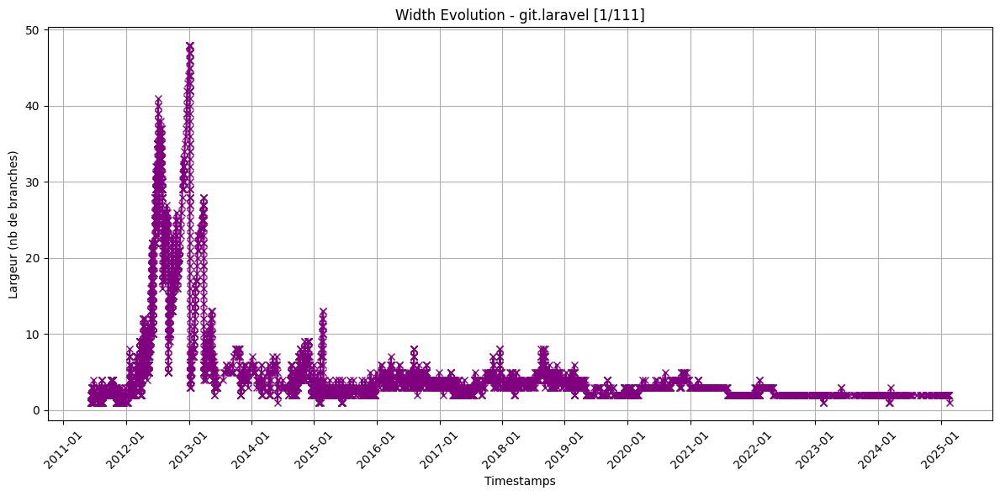

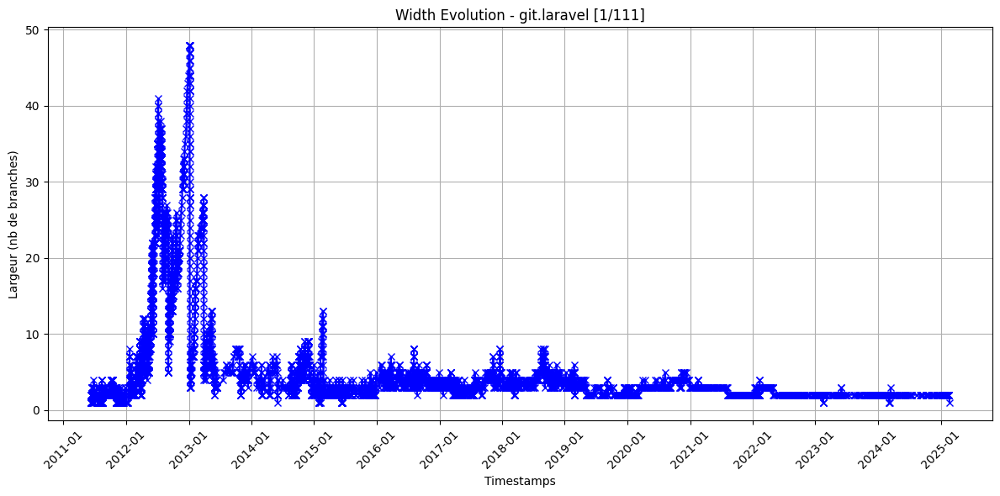

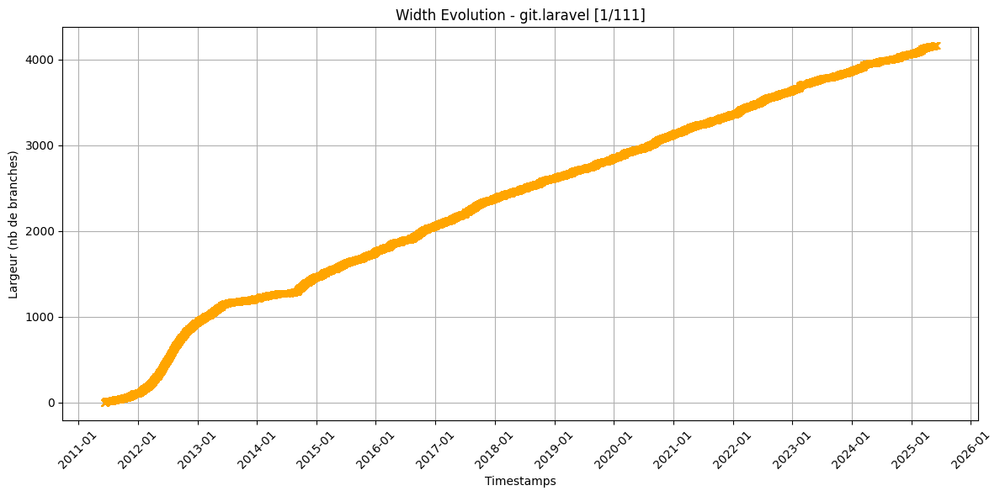

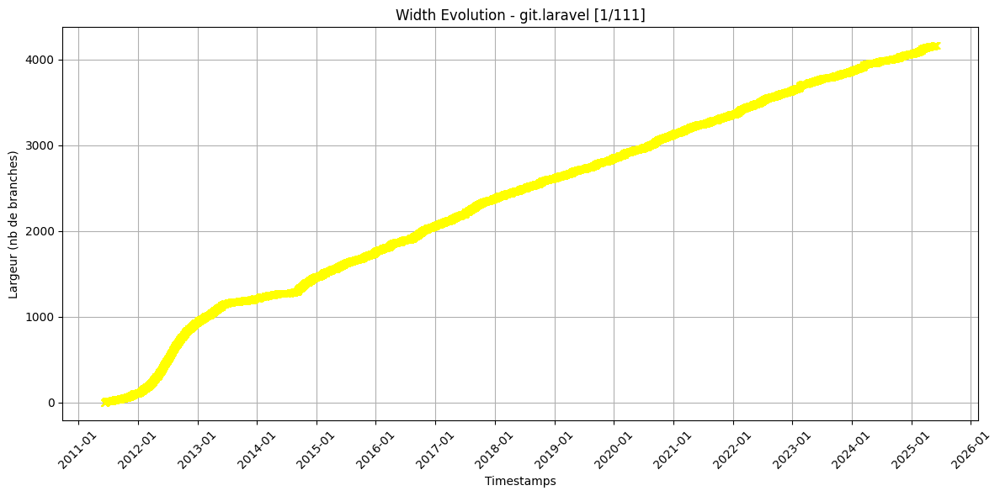

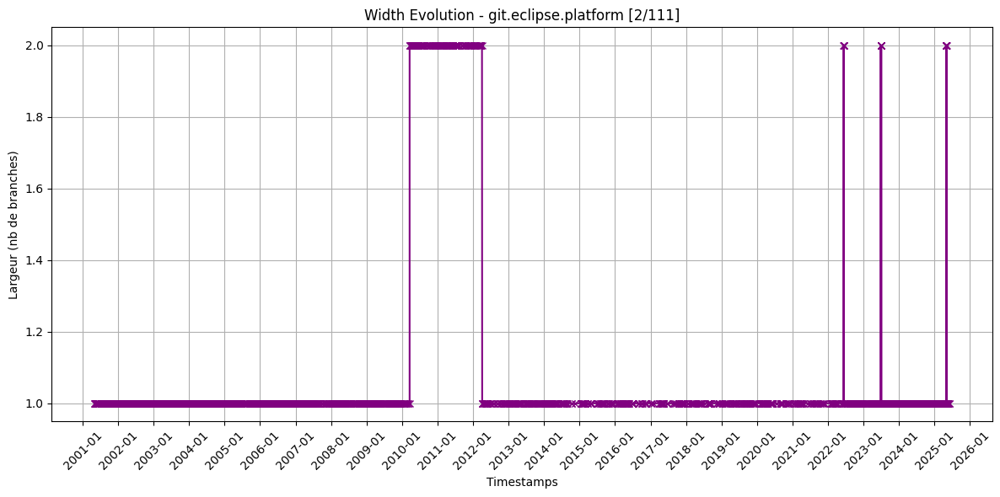

...

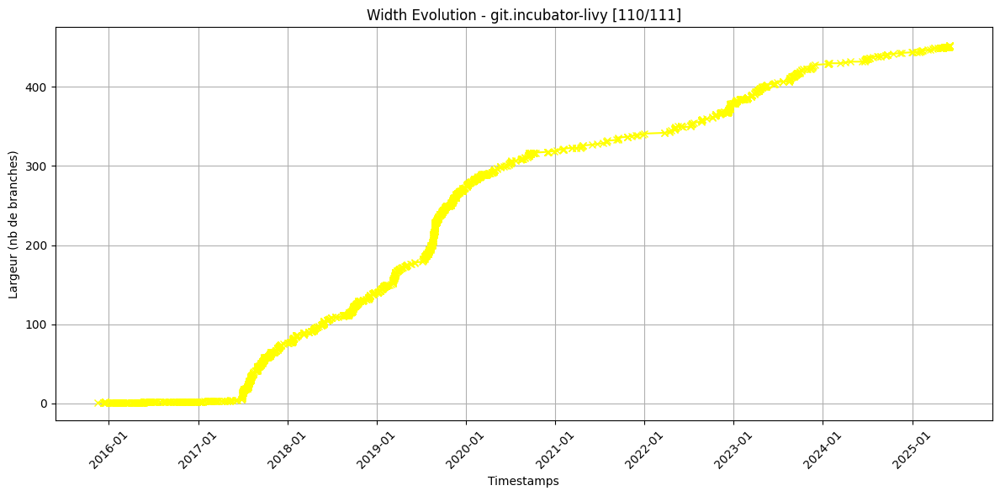

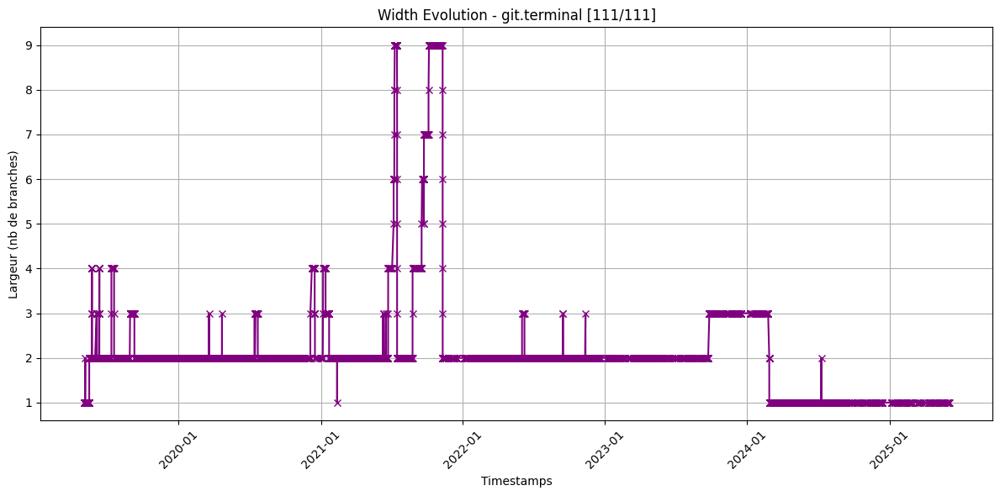

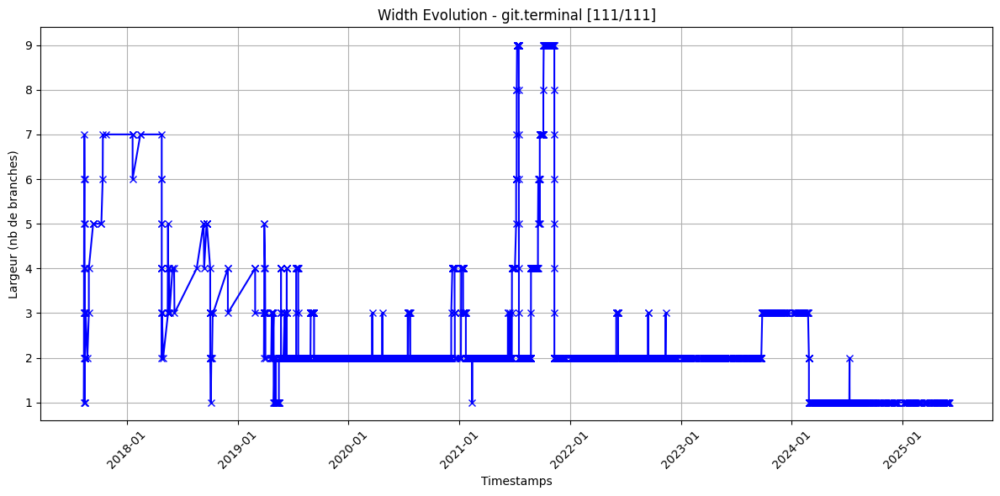

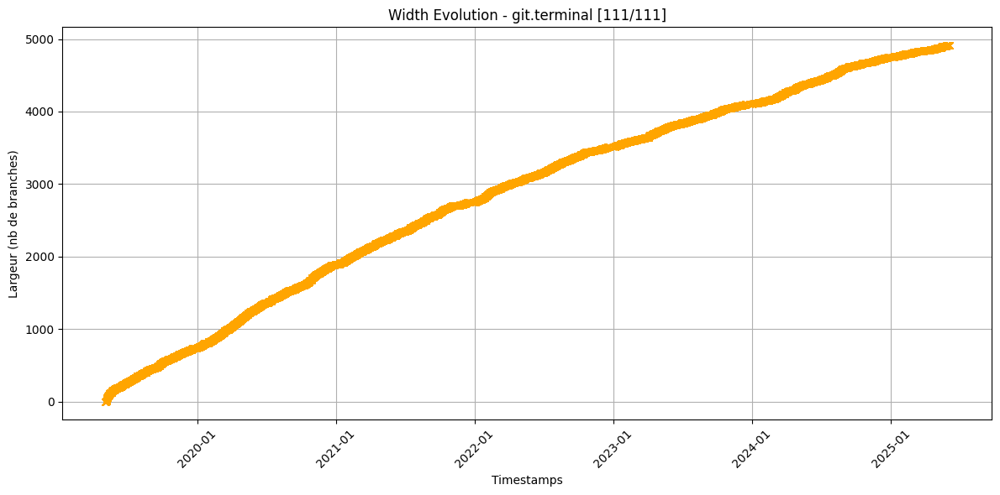

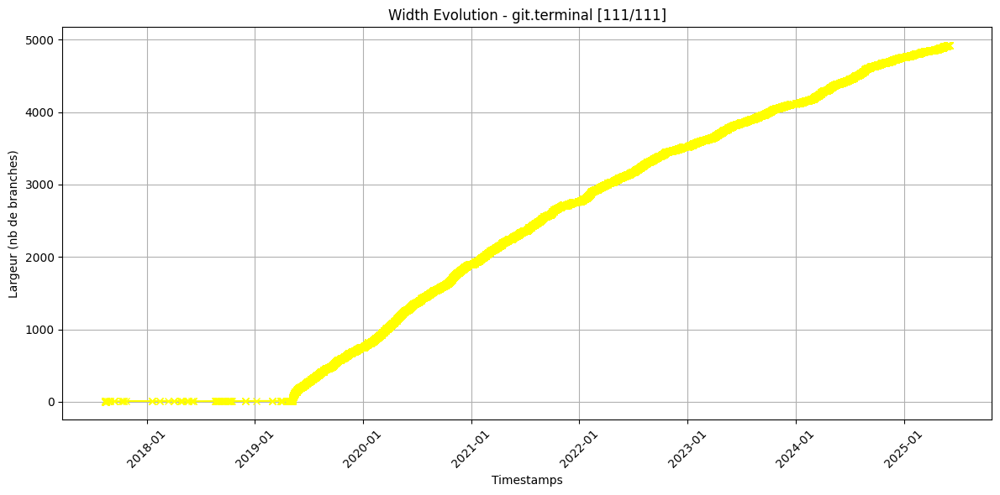

In [4]:
# ATTENTION : Prend quelques minutes à afficher les graphiques

i = 0
total = len(os.listdir(widthOR_dir))
for file in os.listdir(widthOR_dir):
    i += 1
    plot_width_evolution(os.path.join(widthOR_dir, file), "WidthMainOnly", "purple", i, total)
    plot_width_evolution(os.path.join(widthAL_dir, file), "WidthMainLeaf", "blue", i, total)
    plot_width_evolution(os.path.join(widthOR_dir, file), "WidthMainRoot", "orange", i, total)
    plot_width_evolution(os.path.join(widthAL_dir, file), "WidthAll", "yellow", i, total)

In [13]:
def plot_width_evolution_graph(file_name, type_g=None):
    if file_name is None:
        return
    file = file_name + "_width.csv"
    match type_g:
        case "MainOnly":
            plot_width_evolution(os.path.join(widthOR_dir, file), "WidthMainOnly", "purple")
        case "MainLeaf":
            plot_width_evolution(os.path.join(widthAL_dir, file), "WidthMainLeaf", "blue")
        case "MainRoot":
            plot_width_evolution(os.path.join(widthOR_dir, file), "WidthMainRoot", "orange")
        case "All":
            plot_width_evolution(os.path.join(widthAL_dir, file), "WidthAll", "yellow")
        case _:
            plot_width_evolution(os.path.join(widthOR_dir, file), "WidthMainOnly", "purple")
            plot_width_evolution(os.path.join(widthAL_dir, file), "WidthMainLeaf", "blue")
            plot_width_evolution(os.path.join(widthOR_dir, file), "WidthMainRoot", "orange")
            plot_width_evolution(os.path.join(widthAL_dir, file), "WidthAll", "yellow")
    
# Exemple : 
# plot_width_evolution_graph("git.eclipse.platform") pour afficher les quatres graphiques
# plot_width_evolution_graph("git.eclipse.platform", "All") pour afficher seulement celui de type "All"

En observant les graphiques de chaque graphe, on voit tout de suite que les graphiques de MainOnly (violet) et MainLeaf (bleu) se ressemblent pour la majorité des graphes. De même pour ceux de MainRoot (orange) et All (jaune). En fait, la plupart des graphes n'ont qu'une seule racine (celle du main) ce qui rend les graphes MainOnly et MainLeaf similaires (on retire juste les feuilles), de même pour All et MainRoot.

Maintenant, on s'intéresse à la forme des graphiques. On voit que si on laisse les feuilles multiples dans les sous-graphes, la largeur est bornée par le nombre de feuille. De plus, les graphiques avec les feuilles semblent se rapprocher de trois formes : une forme de droite, une forme de courbe exponentielle et une forme de courbe logarithmique. Parfois, les formes sont un peu plus chaotiques ou commencent plus tard mais ces trois patternes semblent êtres ceux que l'on retrouve en majorité.

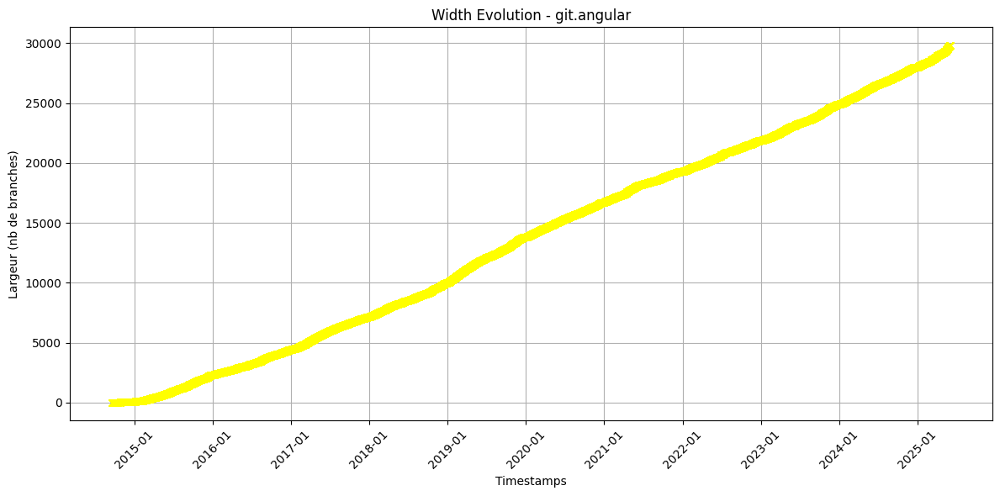

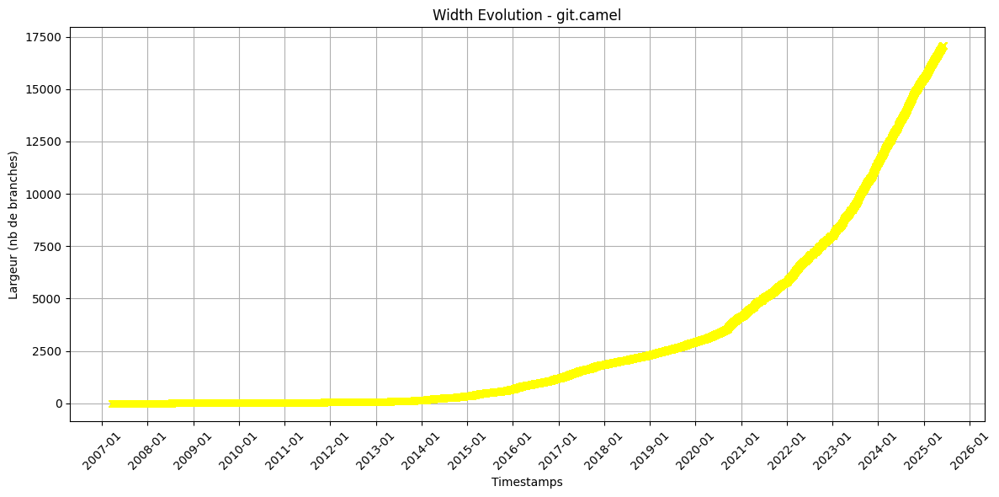

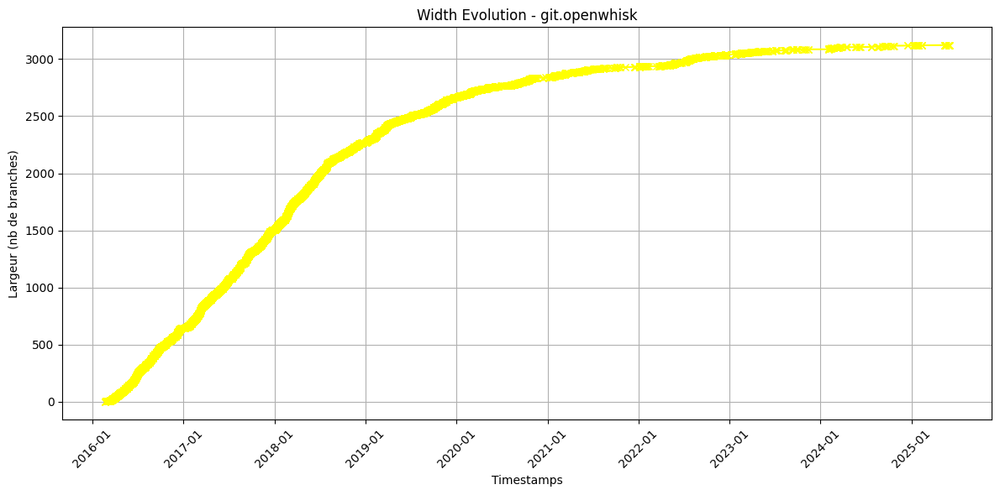

In [18]:
plot_width_evolution_graph("git.angular", "All")
plot_width_evolution_graph("git.camel", "All")
plot_width_evolution_graph("git.openwhisk", "All")

Ces formes dans les largeurs des sous-graphes contenant les feuilles semblent traduire de trois type d'activité :
- cas droite : des utilisateurs travaillent sur le projet en continu en créant des branches sur toute la durée de vie du projet.
- cas exponentielle : des utilisateurs portent de l'intérête au projet plus tard dans sa durée de vie et je mettent à vraiment travailler dessus sur les dates les plus récentes.
- cas logarithme : des utilisateurs travaillent beaucoup au début du projet puis s'y intéressent de moins en moins sur la fin.

Ce qui est intéressant c'est que le nombre de branche baisse peu pendant la durée de vie du projet et on atteint systématiquement le nombre maximal de feuilles (ou branches) à la dernière date disponible. Cela signifie que les branches ajoutées sont très peu merge.

Regardons un autre sous-graphe, celui avec les branches qui commencent et finissent sur le main (MainOnly / violet). La forme de ces graphes est bien plus chaotique et la largeur n'est pas bornée par les feuilles cette fois-ci. La majorité des graphiques semblent présenter un pic d'activité à un moment dans le développement (parfois au début, parfois vers la fin). Une fois ce pic passé, les branches ouvertes merge avec le main contrairement aux graphes à feuilles multiples. Il faut préciser que si certains graphiques semblent "verticaux" c'est car certains timestamps sont très proches par rapport à l'échelle de temps complète du graphe. Voici quelques exemples de pic : 

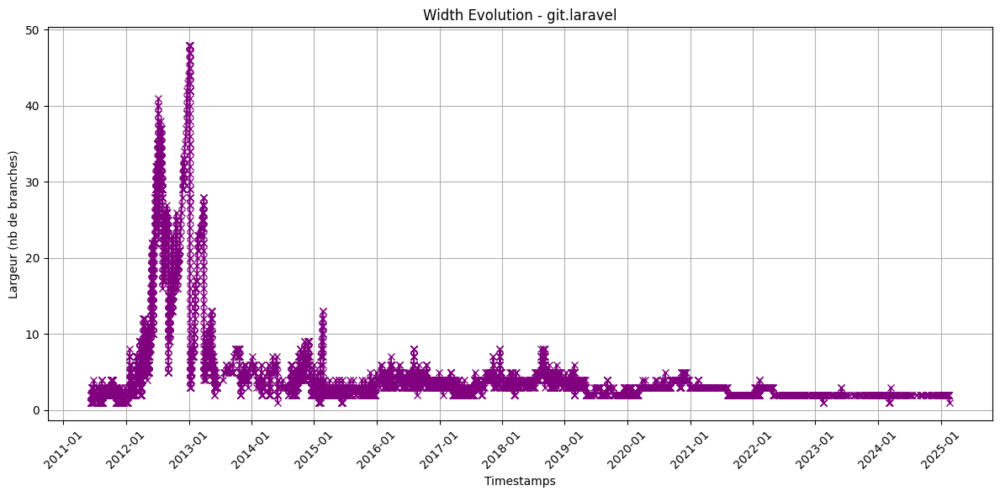

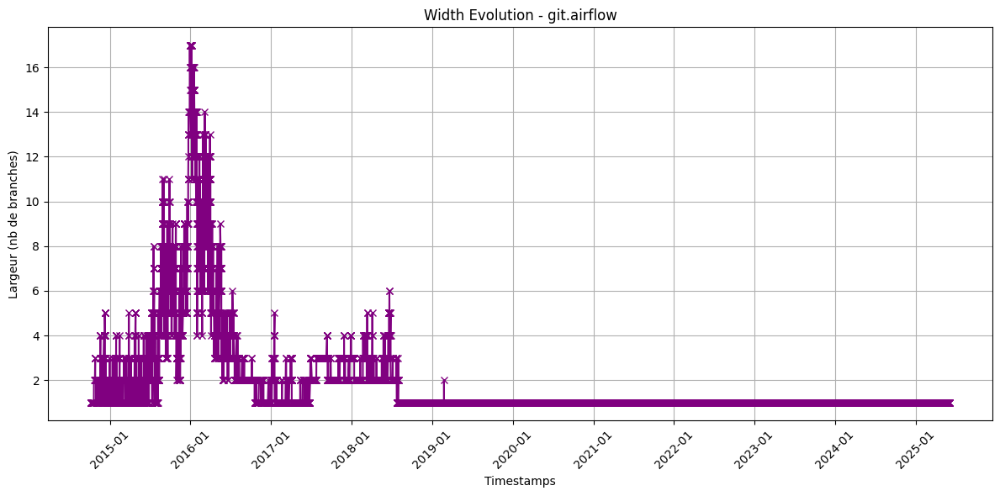

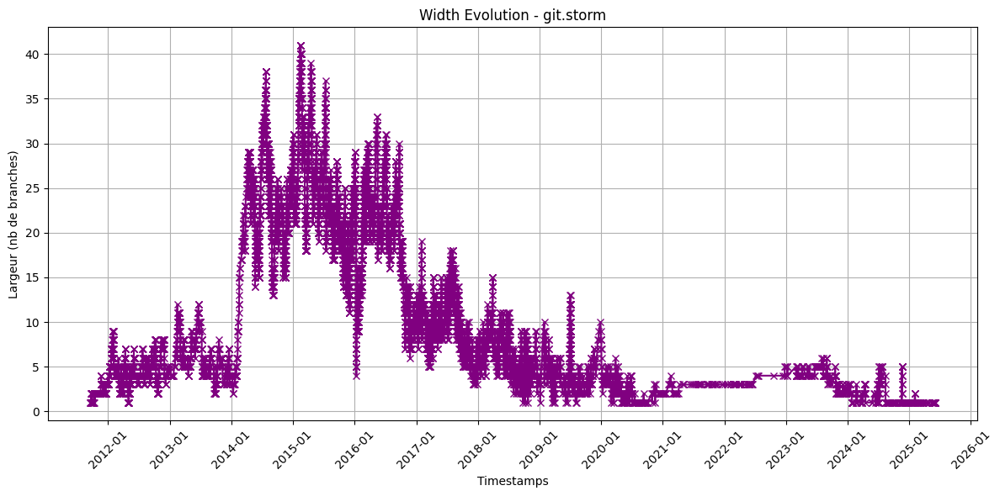

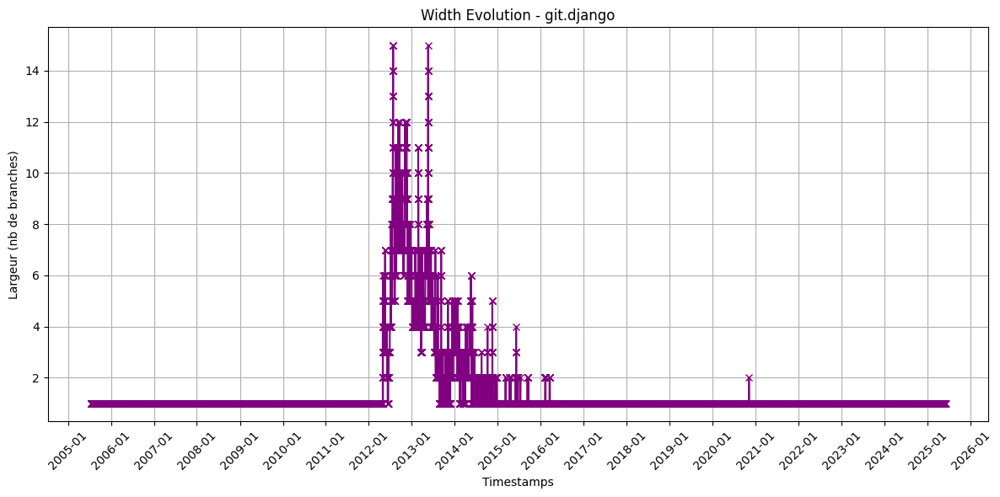

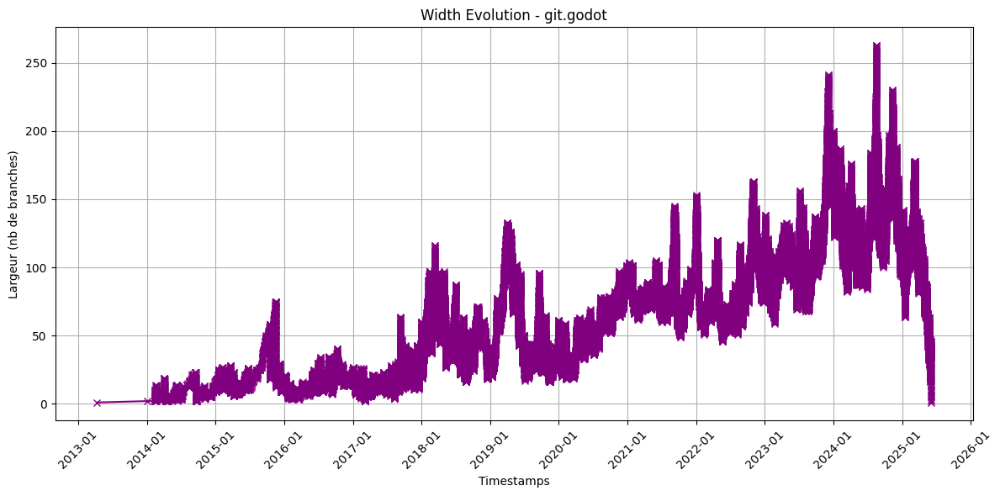

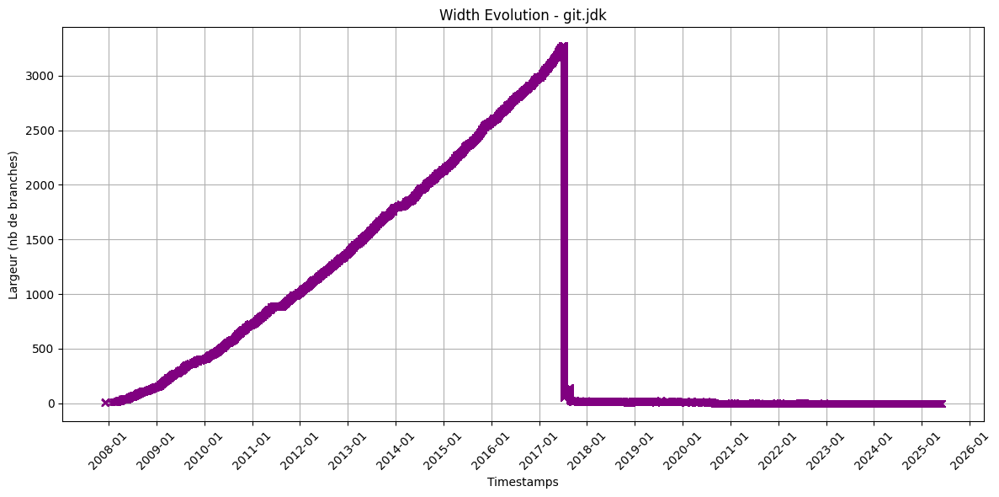

In [38]:
plot_width_evolution_graph("git.laravel", "MainOnly")
plot_width_evolution_graph("git.airflow", "MainOnly")
plot_width_evolution_graph("git.storm", "MainOnly")
plot_width_evolution_graph("git.django", "MainOnly")
plot_width_evolution_graph("git.godot", "MainOnly")
plot_width_evolution_graph("git.jdk", "MainOnly")

Ce pic peut commencer soudainement (git.laravel, git.airflow, git.django), il peut aussi commencer doucement (git.godot, git.jdk) et il peut finir soudainement (git.jdk, git.godot) ou finir doucement (git.storm).

On peut donc en déduire que selon la méthode de travail, les branches sont ouvertes progressivement ou plusieurs en même temps, et elles sont merge sur un temps très court ou progressivement dans le temps.

## 3. Largeur Maximale

On va maintenant s'intéresser à la largeur maximale des graphes. 

Comme on l'a vu avec l'évolution de la largeur, si on prend le graphe entier, la largeur maximale correspond en fait au nombre de feuilles ce qui n'est pas très intéressant dans notre cas. On va donc ne prendre que le main et les branches qui commencent et se terminent dans le main. On va s'appuyer sur le CSV **stats_width_main_only.csv** qui contient :
- Type et File name : le type et le nom du fichier
- Nodes count : le nombre de noeud du graphe "MainOnly"
- Max width : la largeur maximale du graphe
- Avg width : la largeur moyenne du graphe

In [6]:
df_l = pd.read_csv("CSV/GitDAG/stats_width_main_only.csv")
df_l

,Type,File name,Nodes count,Max width,Avg width
0,small,git.age.tdag,764,2,1.0985
1,small,git.answer.tdag,5296,15,7.0459
2,small,git.flink-cdc.tdag,1340,1,1.0000
3,small,git.fury.tdag,1205,3,1.0100
4,small,git.guacamole-server.tdag,3250,11,3.0981
...,...,...,...,...,...
106,large,git.spark.tdag,44533,27,2.6322
107,large,git.swift.tdag,184206,85,32.9808
108,large,git.symfony.tdag,74327,63,25.9661
109,large,git.tensorflow.tdag,177349,166,65.5969


On va d'abord observer la répartition les largeurs maximales des graphes (abscisse = largeur, ordonnée = nombre de graphes avec cette largeur) :

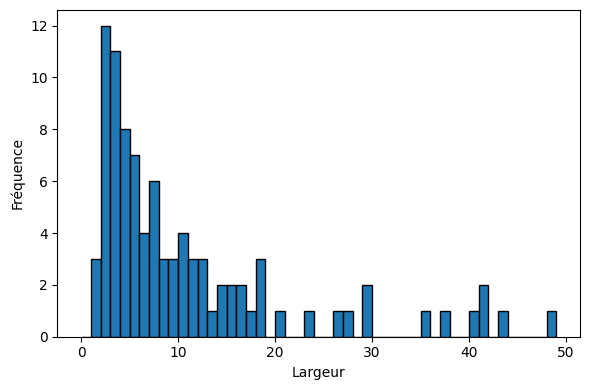

In [40]:
col = "Max width"
val = df_l[col]
plt.figure(figsize=(6, 4))
val.plot.hist(bins=range(0, 50, 1), edgecolor='black')
plt.xlabel('Largeur')
plt.ylabel('Fréquence')
plt.tight_layout()
plt.show()

On se rend compte que la plupart des graphes "MainOnly" sont très peu larges (souvent entre 1 et 20 de largeur).  

Maintenant, prenons en compte le nombre de noeuds et calculons les ratios entre largeur maximale et nombre de noeuds.
Voici l'évolution des ratios entre largeur maximale et nombre de noeuds en fonction du nombre de noeuds (abscisse = nombre de noeuds du graphe, ordonnée = ratio largeur max/nombre de noeuds):

In [20]:
def draw_evo_git(ratios, title):
    x_labels = [f"{size}" for size in ratios.keys()]
    x = list(sorted(ratios.keys()))
    y = [ratios[size] for size in x]
    mean = np.mean(y)
    med = np.median(y)
    print("Min : ", min(y))
    print("Max : ", max(y))

    plt.figure(figsize=(10, 5))
    plt.axhline(mean, color='red', linestyle='--', label=f'Moyenne = {mean:.4f} = 1/500')
    plt.axhline(med, color='purple', linestyle='--', label=f'Mediane= {med:.4f} = 1/1000')
    plt.axhline(max(y), color='orange', linestyle='--', label=f'Max = {max(y):.4f} = 1/20')
    plt.axhline(min(y), color='blue', linestyle='--', label=f'Min = {min(y):.6f} = 1/100000')
    plt.plot(x, y, marker='o')
    plt.title(f"Ratios Nb de noeuds / largeur max ({title})")
    plt.xticks(rotation=45)
    plt.grid(True)
    plt.legend()
    plt.tight_layout()
    plt.show() 

Min :  1.3150182599678384e-05
Max :  0.0449438202247191


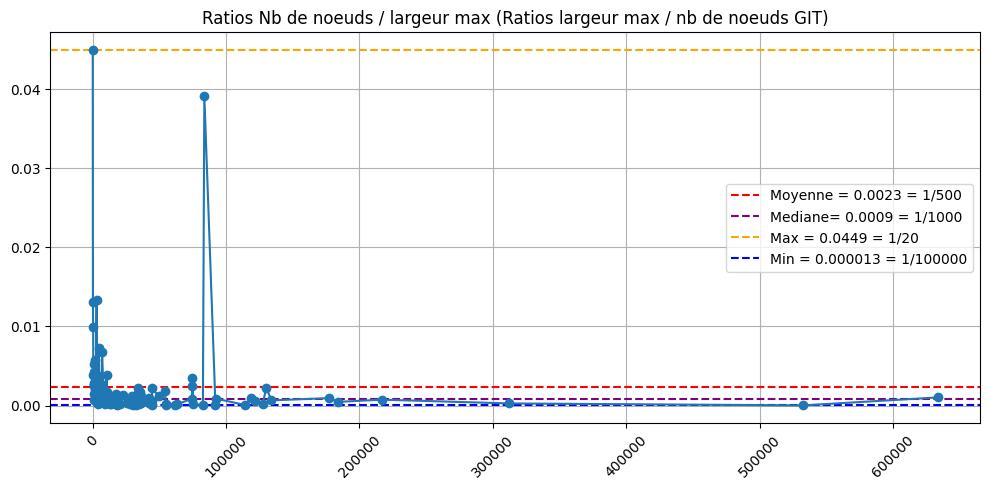

Largeur max :
      Type     File name  Nodes count  Max width  Avg width
90  large  git.jdk.tdag        83736       3278   974.0058


In [36]:
ratios_git = {row["Nodes count"] : row["Max width"]/row["Nodes count"] for idx, row in df_l.iterrows()}
draw_evo_git(ratios_git, 'Ratios largeur max / nb de noeuds GIT')

max_l = df_l["Max width"].max()
l = df_l[df_l["Max width"] == max_l]
print("Largeur max :\n", l)

Ici, on ne prend pas en compte la moyenne car on a des valeurs extrêmes ce qui fausse la moyenne. Prennons plutôt la médiane, on voit tout de suite que la majorité des graphes ont un ratio en dessous de $\frac{1}{1000}$. Ainsi, la plupart des graphes de type MainOnly ont une largeur d'au plus $\frac{n}{1000}$ si $n$ est le nombre de noeuds du graphe.

On a donc une caractérisituqe supplémentaire des graphes de Git : ils sont très peu large autour du main par rapport à leur nombre de noeuds.

## 4. Conclusion

Pour conclure sur nos observations, on arrive à tirer plusieurs caractéristiques de graphes de projets git.

D'abord, si on prend les graphes entiers, la largeur est bornée par le nombre de feuilles du graphe. De plus, l'évolution de la largeur suit en général trois schémas d'évolution qui se rapprochent de fonctions : "droite", "exponentielle" ou "logarithmique".

Si maintenant on s'intéresse à la largeur des graphes de type "MainOnly", l'évolution de cette dernière présente des pic d'activité de plusieurs formes différentes : des pic plus abrupts ou plus doux selon le mode de travail ou le contexte de développement. Enfin, la largeur maximale de ces graphes est souvent très petite par rapport à la taille des graphes (ou nombre de noeuds). On parle ici d'une largeur d'au plus $\frac{n}{1000}$ dans la majorité des cas (avec $n$ le nombre de noeuds).